In [3]:
import json
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
import matplotlib
import operator
import scipy
import math

import numpy as np
import scipy as sp
from  operator import itemgetter
from scipy.stats import norm


import collections
from collections import Counter
from statistics import mean #per la media

In [4]:
dates = ["03-05-21", "10-05-21", "17-05-21", "24-05-21", "31-05-21", "07-06-21", "14-06-21", "21-06-21", "28-06-21", "05-07-21", "12-07-21", "19-07-21", "26-07-21", "02-08-21", "09-08-21",
"16-08-21", "23-08-21", "30-08-21"]

historic_filenames = ['output/grafi_all/multigrafo_' + str(date) + '.gml' for date in dates]
historic_filenames_nn = ['output/grafi_notnull/multigrafo_' + str(date) + '.gml' for date in dates]



In [5]:
#prendo i grafi memorizzati nei file gml e li memorizzo tutti in un array
all_ln = []
num_node_list = []
num_open_channels_list = []
for graph_file in historic_filenames:
    ln_s = nx.read_gml(graph_file)
    all_ln.append(ln_s)
    #memorizzo il numero di nodi della rete in quella data
    num_node_list.append(len(ln_s.nodes()))
    #memorizzo il numero di canali aperti della rete in quel giorno
    num_open_channels_list.append(len(ln_s.edges()))

In [6]:
display(num_node_list)
display(num_open_channels_list)

[10988,
 10329,
 3993,
 3978,
 3967,
 3935,
 3927,
 3918,
 3908,
 3905,
 3887,
 3878,
 3871,
 3854,
 3846,
 3843,
 3838,
 3833]

[42563,
 36762,
 7254,
 7228,
 7204,
 7141,
 7125,
 7116,
 7093,
 7088,
 7047,
 7037,
 7025,
 6994,
 6981,
 6976,
 6969,
 6962]

In [9]:
#prendo i grafi memorizzati nei file gml e li memorizzo tutti in un array
all_ln_nn = []
num_node_list_nn = []
num_open_channels_list_nn = []
for graph in historic_filenames_nn:
    ln = nx.read_gml(graph)
    all_ln_nn.append(ln)
    #memorizzo il numero di nodi della rete in quella data
    num_node_list_nn.append(len(ln.nodes()))
    #memorizzo il numero di canali aperti della rete in quel giorno
    num_open_channels_list_nn.append(len(ln.edges()))

In [10]:
display(num_node_list_nn)
display(num_open_channels_list_nn)

[8404, 7554, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]

[35215, 29490, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]

In [5]:
sets_channels = [set(ln.edges()) for ln in all_ln]
#canali che tutti i dataset hanno in comune
common_channels = set.intersection(*sets_channels)

In [ ]:
display(common_channels)

In [30]:
DATES = ["03/05","10/05","17/05","24/05","31/05","07/06","14/06","21/06","28/06","05/07","12/07","19/07","26/07","02/08","09/08","16/08","23/08","30/08"]
FIGSIZE=(13, 6)
LABELSIZE = 20
TICKSIZE = 18
DIR = 'plots/'

### *Grafico distribuzione nodi e canali nel tempo*

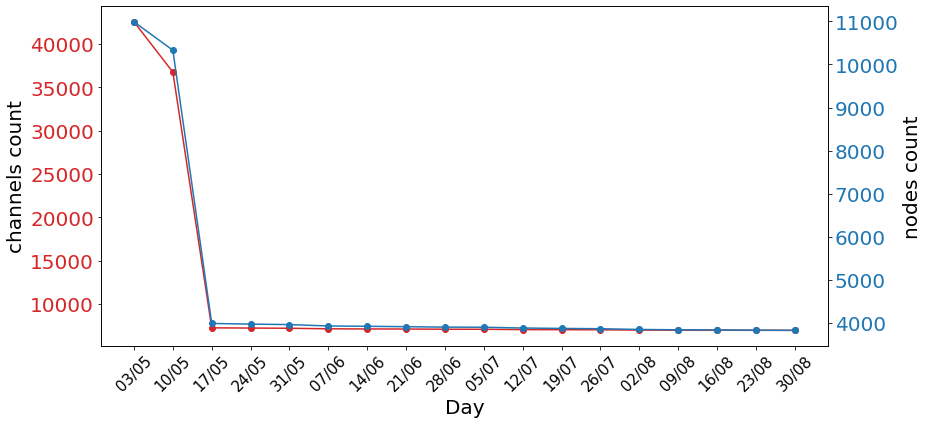

In [31]:
# Distribuzione dei nodi e canali nel tempo
fig, ax1 = plt.subplots()
fig.set_figheight(FIGSIZE[1])
fig.set_figwidth(FIGSIZE[0])

color = 'tab:red'
ax1.set_xlabel('Day', fontsize=LABELSIZE)
ax1.set_ylabel('channels count', fontsize=LABELSIZE)
#ax1.set_yscale('log')
ax1.plot(DATES, num_open_channels_list, color=color, marker='o')
ax1.tick_params(axis='y', labelcolor=color, labelsize=LABELSIZE)
ax1.tick_params(axis='x', rotation=45, labelsize=LABELSIZE-5)

ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis

color = 'tab:blue'
ax2.set_ylabel('nodes count', fontsize=LABELSIZE)  # we already handled the x-label with ax1
#ax2.set_yscale('log')
ax2.plot(DATES, num_node_list, color=color, marker='o')
ax2.tick_params(axis='y', labelcolor=color, labelsize=LABELSIZE)

fig.tight_layout()  # otherwise the right y-label is slightly clipped

#plt.savefig(os.path.join(DIR  + "monthly" + "distr_nodes_channels_month.png"))


### si

In [43]:
htlc1=[]

for ln in all_ln:

    d = [d.get('MINHTLC1') for d in ln.get_edge_data('03bd3466efd4a7306b539e2314e69efc6b1eaee29734fcedd78cf81b1dde9fedf8', '03c3d14714b78f03fd6ea4997c2b540a4139258249ea1d625c03b68bb82f85d0ea').values()]
    htlc1 = htlc1 + d

display(htlc1)

[-1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1]

In [44]:
dict_fees = {}
for c1,c2 in common_channels:
    dict_fees[c1,c2] = {'HTLC1':[], 'HTLC2':[], 'FEEBASE1':[], 'FEEBASE2':[], 'FEERATE1':[], 'FEERATE2':[]}

    for ln in all_ln:
        h1 = [d.get('MINHTLC1') for d in ln.get_edge_data('03bd3466efd4a7306b539e2314e69efc6b1eaee29734fcedd78cf81b1dde9fedf8', '03c3d14714b78f03fd6ea4997c2b540a4139258249ea1d625c03b68bb82f85d0ea').values()]
        dict_fees[c1,c2]['HTLC1'] =  dict_fees[c1,c2]['HTLC1'] + h1

#display(dict_fees)   

In [7]:
for ln in all_ln:
   d.get('MINHTLC1',-1) for d in ln.get_edge_data(edge[0],edge[1]).values()


MultiEdgeDataView([('03bd3466efd4a7306b539e2314e69efc6b1eaee29734fcedd78cf81b1dde9fedf8', '03c3d14714b78f03fd6ea4997c2b540a4139258249ea1d625c03b68bb82f85d0ea', -1), ('03bd3466efd4a7306b539e2314e69efc6b1eaee29734fcedd78cf81b1dde9fedf8', '03cbf298b068300be33f06c947b9d3f00a0f0e8089da3233f5db37e81d3a596fe1', -1), ('03bd3466efd4a7306b539e2314e69efc6b1eaee29734fcedd78cf81b1dde9fedf8', '0269ba746a03bb9b8225c4e78a85b5b8674a5b45ac425860944922460e94241932', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '02ee4469f2b686d5d02422917ac199602ce4c366a7bfaac1099e3ade377677064d', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '02ee4469f2b686d5d02422917ac199602ce4c366a7bfaac1099e3ade377677064d', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '022e74ed3ddd3f590fd6492e60b20dcad7303f17e1ffd882fb33bb3f6c88f64398', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '03cbf298b068300be33f06c947b9d3f00

MultiEdgeDataView([('03bd3466efd4a7306b539e2314e69efc6b1eaee29734fcedd78cf81b1dde9fedf8', '03c3d14714b78f03fd6ea4997c2b540a4139258249ea1d625c03b68bb82f85d0ea', -1), ('03bd3466efd4a7306b539e2314e69efc6b1eaee29734fcedd78cf81b1dde9fedf8', '03cbf298b068300be33f06c947b9d3f00a0f0e8089da3233f5db37e81d3a596fe1', -1), ('03bd3466efd4a7306b539e2314e69efc6b1eaee29734fcedd78cf81b1dde9fedf8', '0269ba746a03bb9b8225c4e78a85b5b8674a5b45ac425860944922460e94241932', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '02ee4469f2b686d5d02422917ac199602ce4c366a7bfaac1099e3ade377677064d', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '02ee4469f2b686d5d02422917ac199602ce4c366a7bfaac1099e3ade377677064d', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '022e74ed3ddd3f590fd6492e60b20dcad7303f17e1ffd882fb33bb3f6c88f64398', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '03cbf298b068300be33f06c947b9d3f00

MultiEdgeDataView([('03bd3466efd4a7306b539e2314e69efc6b1eaee29734fcedd78cf81b1dde9fedf8', '03c3d14714b78f03fd6ea4997c2b540a4139258249ea1d625c03b68bb82f85d0ea', -1), ('03bd3466efd4a7306b539e2314e69efc6b1eaee29734fcedd78cf81b1dde9fedf8', '03cbf298b068300be33f06c947b9d3f00a0f0e8089da3233f5db37e81d3a596fe1', -1), ('03bd3466efd4a7306b539e2314e69efc6b1eaee29734fcedd78cf81b1dde9fedf8', '0269ba746a03bb9b8225c4e78a85b5b8674a5b45ac425860944922460e94241932', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '02ee4469f2b686d5d02422917ac199602ce4c366a7bfaac1099e3ade377677064d', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '02ee4469f2b686d5d02422917ac199602ce4c366a7bfaac1099e3ade377677064d', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '022e74ed3ddd3f590fd6492e60b20dcad7303f17e1ffd882fb33bb3f6c88f64398', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '03cbf298b068300be33f06c947b9d3f00

MultiEdgeDataView([('03bd3466efd4a7306b539e2314e69efc6b1eaee29734fcedd78cf81b1dde9fedf8', '03c3d14714b78f03fd6ea4997c2b540a4139258249ea1d625c03b68bb82f85d0ea', -1), ('03bd3466efd4a7306b539e2314e69efc6b1eaee29734fcedd78cf81b1dde9fedf8', '03cbf298b068300be33f06c947b9d3f00a0f0e8089da3233f5db37e81d3a596fe1', -1), ('03bd3466efd4a7306b539e2314e69efc6b1eaee29734fcedd78cf81b1dde9fedf8', '0269ba746a03bb9b8225c4e78a85b5b8674a5b45ac425860944922460e94241932', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '02ee4469f2b686d5d02422917ac199602ce4c366a7bfaac1099e3ade377677064d', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '02ee4469f2b686d5d02422917ac199602ce4c366a7bfaac1099e3ade377677064d', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '022e74ed3ddd3f590fd6492e60b20dcad7303f17e1ffd882fb33bb3f6c88f64398', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '03cbf298b068300be33f06c947b9d3f00

MultiEdgeDataView([('03bd3466efd4a7306b539e2314e69efc6b1eaee29734fcedd78cf81b1dde9fedf8', '03c3d14714b78f03fd6ea4997c2b540a4139258249ea1d625c03b68bb82f85d0ea', -1), ('03bd3466efd4a7306b539e2314e69efc6b1eaee29734fcedd78cf81b1dde9fedf8', '03cbf298b068300be33f06c947b9d3f00a0f0e8089da3233f5db37e81d3a596fe1', -1), ('03bd3466efd4a7306b539e2314e69efc6b1eaee29734fcedd78cf81b1dde9fedf8', '0269ba746a03bb9b8225c4e78a85b5b8674a5b45ac425860944922460e94241932', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '02ee4469f2b686d5d02422917ac199602ce4c366a7bfaac1099e3ade377677064d', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '02ee4469f2b686d5d02422917ac199602ce4c366a7bfaac1099e3ade377677064d', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '022e74ed3ddd3f590fd6492e60b20dcad7303f17e1ffd882fb33bb3f6c88f64398', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '03cbf298b068300be33f06c947b9d3f00

MultiEdgeDataView([('03bd3466efd4a7306b539e2314e69efc6b1eaee29734fcedd78cf81b1dde9fedf8', '03c3d14714b78f03fd6ea4997c2b540a4139258249ea1d625c03b68bb82f85d0ea', -1), ('03bd3466efd4a7306b539e2314e69efc6b1eaee29734fcedd78cf81b1dde9fedf8', '03cbf298b068300be33f06c947b9d3f00a0f0e8089da3233f5db37e81d3a596fe1', -1), ('03bd3466efd4a7306b539e2314e69efc6b1eaee29734fcedd78cf81b1dde9fedf8', '0269ba746a03bb9b8225c4e78a85b5b8674a5b45ac425860944922460e94241932', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '02ee4469f2b686d5d02422917ac199602ce4c366a7bfaac1099e3ade377677064d', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '02ee4469f2b686d5d02422917ac199602ce4c366a7bfaac1099e3ade377677064d', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '022e74ed3ddd3f590fd6492e60b20dcad7303f17e1ffd882fb33bb3f6c88f64398', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '03cbf298b068300be33f06c947b9d3f00

MultiEdgeDataView([('03bd3466efd4a7306b539e2314e69efc6b1eaee29734fcedd78cf81b1dde9fedf8', '03c3d14714b78f03fd6ea4997c2b540a4139258249ea1d625c03b68bb82f85d0ea', -1), ('03bd3466efd4a7306b539e2314e69efc6b1eaee29734fcedd78cf81b1dde9fedf8', '03cbf298b068300be33f06c947b9d3f00a0f0e8089da3233f5db37e81d3a596fe1', -1), ('03bd3466efd4a7306b539e2314e69efc6b1eaee29734fcedd78cf81b1dde9fedf8', '0269ba746a03bb9b8225c4e78a85b5b8674a5b45ac425860944922460e94241932', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '02ee4469f2b686d5d02422917ac199602ce4c366a7bfaac1099e3ade377677064d', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '02ee4469f2b686d5d02422917ac199602ce4c366a7bfaac1099e3ade377677064d', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '022e74ed3ddd3f590fd6492e60b20dcad7303f17e1ffd882fb33bb3f6c88f64398', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '03cbf298b068300be33f06c947b9d3f00

MultiEdgeDataView([('03bd3466efd4a7306b539e2314e69efc6b1eaee29734fcedd78cf81b1dde9fedf8', '03c3d14714b78f03fd6ea4997c2b540a4139258249ea1d625c03b68bb82f85d0ea', -1), ('03bd3466efd4a7306b539e2314e69efc6b1eaee29734fcedd78cf81b1dde9fedf8', '03cbf298b068300be33f06c947b9d3f00a0f0e8089da3233f5db37e81d3a596fe1', -1), ('03bd3466efd4a7306b539e2314e69efc6b1eaee29734fcedd78cf81b1dde9fedf8', '0269ba746a03bb9b8225c4e78a85b5b8674a5b45ac425860944922460e94241932', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '02ee4469f2b686d5d02422917ac199602ce4c366a7bfaac1099e3ade377677064d', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '02ee4469f2b686d5d02422917ac199602ce4c366a7bfaac1099e3ade377677064d', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '022e74ed3ddd3f590fd6492e60b20dcad7303f17e1ffd882fb33bb3f6c88f64398', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '03cbf298b068300be33f06c947b9d3f00

MultiEdgeDataView([('03bd3466efd4a7306b539e2314e69efc6b1eaee29734fcedd78cf81b1dde9fedf8', '03c3d14714b78f03fd6ea4997c2b540a4139258249ea1d625c03b68bb82f85d0ea', -1), ('03bd3466efd4a7306b539e2314e69efc6b1eaee29734fcedd78cf81b1dde9fedf8', '03cbf298b068300be33f06c947b9d3f00a0f0e8089da3233f5db37e81d3a596fe1', -1), ('03bd3466efd4a7306b539e2314e69efc6b1eaee29734fcedd78cf81b1dde9fedf8', '0269ba746a03bb9b8225c4e78a85b5b8674a5b45ac425860944922460e94241932', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '02ee4469f2b686d5d02422917ac199602ce4c366a7bfaac1099e3ade377677064d', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '02ee4469f2b686d5d02422917ac199602ce4c366a7bfaac1099e3ade377677064d', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '022e74ed3ddd3f590fd6492e60b20dcad7303f17e1ffd882fb33bb3f6c88f64398', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '03cbf298b068300be33f06c947b9d3f00

MultiEdgeDataView([('03bd3466efd4a7306b539e2314e69efc6b1eaee29734fcedd78cf81b1dde9fedf8', '03c3d14714b78f03fd6ea4997c2b540a4139258249ea1d625c03b68bb82f85d0ea', -1), ('03bd3466efd4a7306b539e2314e69efc6b1eaee29734fcedd78cf81b1dde9fedf8', '03cbf298b068300be33f06c947b9d3f00a0f0e8089da3233f5db37e81d3a596fe1', -1), ('03bd3466efd4a7306b539e2314e69efc6b1eaee29734fcedd78cf81b1dde9fedf8', '0269ba746a03bb9b8225c4e78a85b5b8674a5b45ac425860944922460e94241932', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '02ee4469f2b686d5d02422917ac199602ce4c366a7bfaac1099e3ade377677064d', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '02ee4469f2b686d5d02422917ac199602ce4c366a7bfaac1099e3ade377677064d', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '022e74ed3ddd3f590fd6492e60b20dcad7303f17e1ffd882fb33bb3f6c88f64398', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '03cbf298b068300be33f06c947b9d3f00

MultiEdgeDataView([('03bd3466efd4a7306b539e2314e69efc6b1eaee29734fcedd78cf81b1dde9fedf8', '03c3d14714b78f03fd6ea4997c2b540a4139258249ea1d625c03b68bb82f85d0ea', -1), ('03bd3466efd4a7306b539e2314e69efc6b1eaee29734fcedd78cf81b1dde9fedf8', '03cbf298b068300be33f06c947b9d3f00a0f0e8089da3233f5db37e81d3a596fe1', -1), ('03bd3466efd4a7306b539e2314e69efc6b1eaee29734fcedd78cf81b1dde9fedf8', '0269ba746a03bb9b8225c4e78a85b5b8674a5b45ac425860944922460e94241932', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '02ee4469f2b686d5d02422917ac199602ce4c366a7bfaac1099e3ade377677064d', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '02ee4469f2b686d5d02422917ac199602ce4c366a7bfaac1099e3ade377677064d', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '022e74ed3ddd3f590fd6492e60b20dcad7303f17e1ffd882fb33bb3f6c88f64398', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '03cbf298b068300be33f06c947b9d3f00

MultiEdgeDataView([('03bd3466efd4a7306b539e2314e69efc6b1eaee29734fcedd78cf81b1dde9fedf8', '03c3d14714b78f03fd6ea4997c2b540a4139258249ea1d625c03b68bb82f85d0ea', -1), ('03bd3466efd4a7306b539e2314e69efc6b1eaee29734fcedd78cf81b1dde9fedf8', '03cbf298b068300be33f06c947b9d3f00a0f0e8089da3233f5db37e81d3a596fe1', -1), ('03bd3466efd4a7306b539e2314e69efc6b1eaee29734fcedd78cf81b1dde9fedf8', '0269ba746a03bb9b8225c4e78a85b5b8674a5b45ac425860944922460e94241932', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '02ee4469f2b686d5d02422917ac199602ce4c366a7bfaac1099e3ade377677064d', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '02ee4469f2b686d5d02422917ac199602ce4c366a7bfaac1099e3ade377677064d', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '022e74ed3ddd3f590fd6492e60b20dcad7303f17e1ffd882fb33bb3f6c88f64398', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '03cbf298b068300be33f06c947b9d3f00

MultiEdgeDataView([('03bd3466efd4a7306b539e2314e69efc6b1eaee29734fcedd78cf81b1dde9fedf8', '03c3d14714b78f03fd6ea4997c2b540a4139258249ea1d625c03b68bb82f85d0ea', -1), ('03bd3466efd4a7306b539e2314e69efc6b1eaee29734fcedd78cf81b1dde9fedf8', '03cbf298b068300be33f06c947b9d3f00a0f0e8089da3233f5db37e81d3a596fe1', -1), ('03bd3466efd4a7306b539e2314e69efc6b1eaee29734fcedd78cf81b1dde9fedf8', '0269ba746a03bb9b8225c4e78a85b5b8674a5b45ac425860944922460e94241932', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '02ee4469f2b686d5d02422917ac199602ce4c366a7bfaac1099e3ade377677064d', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '02ee4469f2b686d5d02422917ac199602ce4c366a7bfaac1099e3ade377677064d', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '022e74ed3ddd3f590fd6492e60b20dcad7303f17e1ffd882fb33bb3f6c88f64398', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '03cbf298b068300be33f06c947b9d3f00

MultiEdgeDataView([('03bd3466efd4a7306b539e2314e69efc6b1eaee29734fcedd78cf81b1dde9fedf8', '03c3d14714b78f03fd6ea4997c2b540a4139258249ea1d625c03b68bb82f85d0ea', -1), ('03bd3466efd4a7306b539e2314e69efc6b1eaee29734fcedd78cf81b1dde9fedf8', '03cbf298b068300be33f06c947b9d3f00a0f0e8089da3233f5db37e81d3a596fe1', -1), ('03bd3466efd4a7306b539e2314e69efc6b1eaee29734fcedd78cf81b1dde9fedf8', '0269ba746a03bb9b8225c4e78a85b5b8674a5b45ac425860944922460e94241932', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '02ee4469f2b686d5d02422917ac199602ce4c366a7bfaac1099e3ade377677064d', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '02ee4469f2b686d5d02422917ac199602ce4c366a7bfaac1099e3ade377677064d', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '022e74ed3ddd3f590fd6492e60b20dcad7303f17e1ffd882fb33bb3f6c88f64398', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '03cbf298b068300be33f06c947b9d3f00

MultiEdgeDataView([('03bd3466efd4a7306b539e2314e69efc6b1eaee29734fcedd78cf81b1dde9fedf8', '03c3d14714b78f03fd6ea4997c2b540a4139258249ea1d625c03b68bb82f85d0ea', -1), ('03bd3466efd4a7306b539e2314e69efc6b1eaee29734fcedd78cf81b1dde9fedf8', '03cbf298b068300be33f06c947b9d3f00a0f0e8089da3233f5db37e81d3a596fe1', -1), ('03bd3466efd4a7306b539e2314e69efc6b1eaee29734fcedd78cf81b1dde9fedf8', '0269ba746a03bb9b8225c4e78a85b5b8674a5b45ac425860944922460e94241932', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '02ee4469f2b686d5d02422917ac199602ce4c366a7bfaac1099e3ade377677064d', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '02ee4469f2b686d5d02422917ac199602ce4c366a7bfaac1099e3ade377677064d', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '022e74ed3ddd3f590fd6492e60b20dcad7303f17e1ffd882fb33bb3f6c88f64398', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '03cbf298b068300be33f06c947b9d3f00

MultiEdgeDataView([('03bd3466efd4a7306b539e2314e69efc6b1eaee29734fcedd78cf81b1dde9fedf8', '03c3d14714b78f03fd6ea4997c2b540a4139258249ea1d625c03b68bb82f85d0ea', -1), ('03bd3466efd4a7306b539e2314e69efc6b1eaee29734fcedd78cf81b1dde9fedf8', '03cbf298b068300be33f06c947b9d3f00a0f0e8089da3233f5db37e81d3a596fe1', -1), ('03bd3466efd4a7306b539e2314e69efc6b1eaee29734fcedd78cf81b1dde9fedf8', '0269ba746a03bb9b8225c4e78a85b5b8674a5b45ac425860944922460e94241932', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '02ee4469f2b686d5d02422917ac199602ce4c366a7bfaac1099e3ade377677064d', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '02ee4469f2b686d5d02422917ac199602ce4c366a7bfaac1099e3ade377677064d', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '022e74ed3ddd3f590fd6492e60b20dcad7303f17e1ffd882fb33bb3f6c88f64398', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '03cbf298b068300be33f06c947b9d3f00

MultiEdgeDataView([('03bd3466efd4a7306b539e2314e69efc6b1eaee29734fcedd78cf81b1dde9fedf8', '03c3d14714b78f03fd6ea4997c2b540a4139258249ea1d625c03b68bb82f85d0ea', -1), ('03bd3466efd4a7306b539e2314e69efc6b1eaee29734fcedd78cf81b1dde9fedf8', '03cbf298b068300be33f06c947b9d3f00a0f0e8089da3233f5db37e81d3a596fe1', -1), ('03bd3466efd4a7306b539e2314e69efc6b1eaee29734fcedd78cf81b1dde9fedf8', '0269ba746a03bb9b8225c4e78a85b5b8674a5b45ac425860944922460e94241932', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '02ee4469f2b686d5d02422917ac199602ce4c366a7bfaac1099e3ade377677064d', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '02ee4469f2b686d5d02422917ac199602ce4c366a7bfaac1099e3ade377677064d', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '022e74ed3ddd3f590fd6492e60b20dcad7303f17e1ffd882fb33bb3f6c88f64398', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '03cbf298b068300be33f06c947b9d3f00

MultiEdgeDataView([('03bd3466efd4a7306b539e2314e69efc6b1eaee29734fcedd78cf81b1dde9fedf8', '03c3d14714b78f03fd6ea4997c2b540a4139258249ea1d625c03b68bb82f85d0ea', -1), ('03bd3466efd4a7306b539e2314e69efc6b1eaee29734fcedd78cf81b1dde9fedf8', '03cbf298b068300be33f06c947b9d3f00a0f0e8089da3233f5db37e81d3a596fe1', -1), ('03bd3466efd4a7306b539e2314e69efc6b1eaee29734fcedd78cf81b1dde9fedf8', '0269ba746a03bb9b8225c4e78a85b5b8674a5b45ac425860944922460e94241932', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '02ee4469f2b686d5d02422917ac199602ce4c366a7bfaac1099e3ade377677064d', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '02ee4469f2b686d5d02422917ac199602ce4c366a7bfaac1099e3ade377677064d', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '022e74ed3ddd3f590fd6492e60b20dcad7303f17e1ffd882fb33bb3f6c88f64398', -1), ('02eccebd9ed98f6d267080a58194dbe554a2b33d976eb95bb7c116d00fd64c4a13', '03cbf298b068300be33f06c947b9d3f00